# Class 7

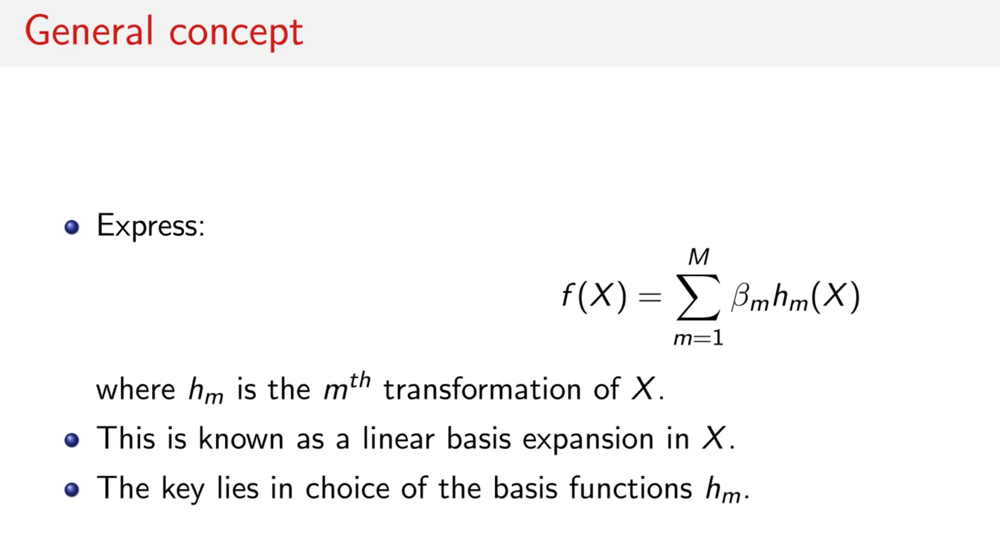

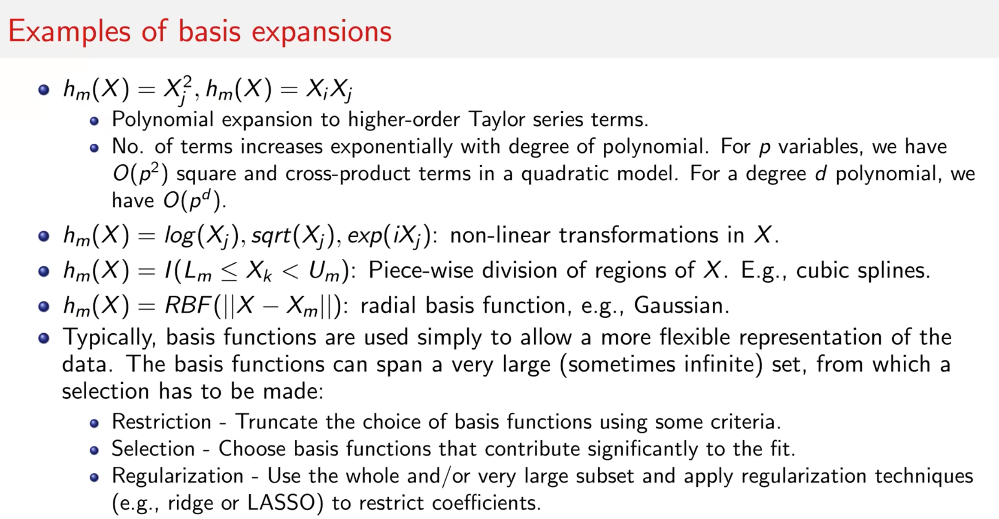

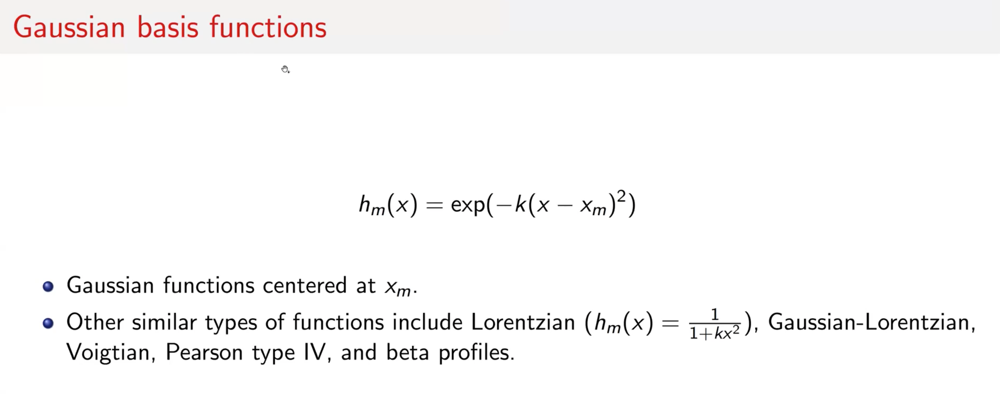

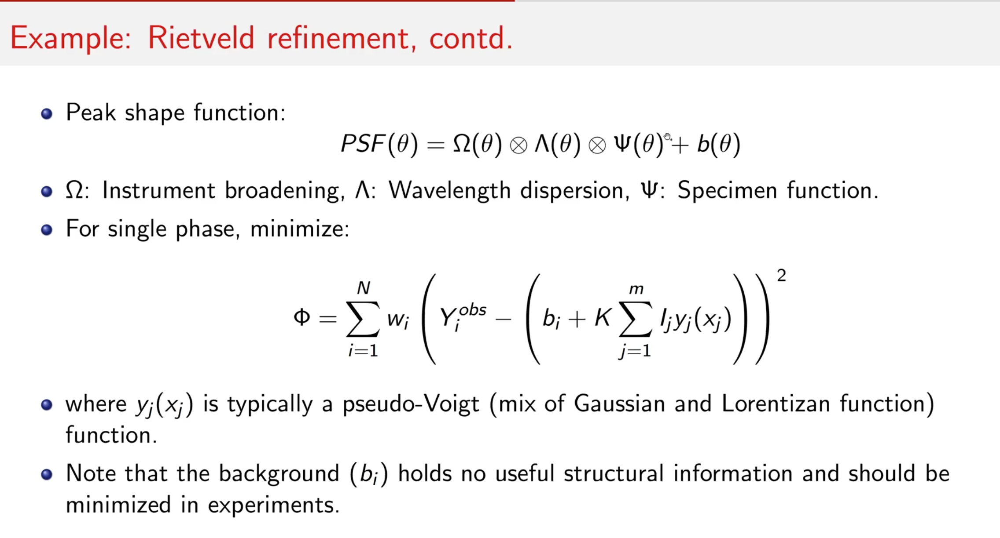

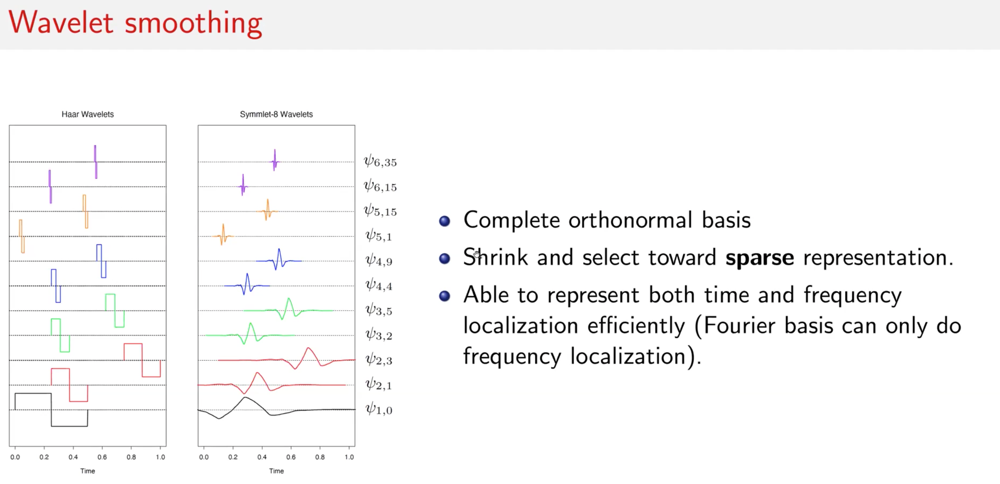

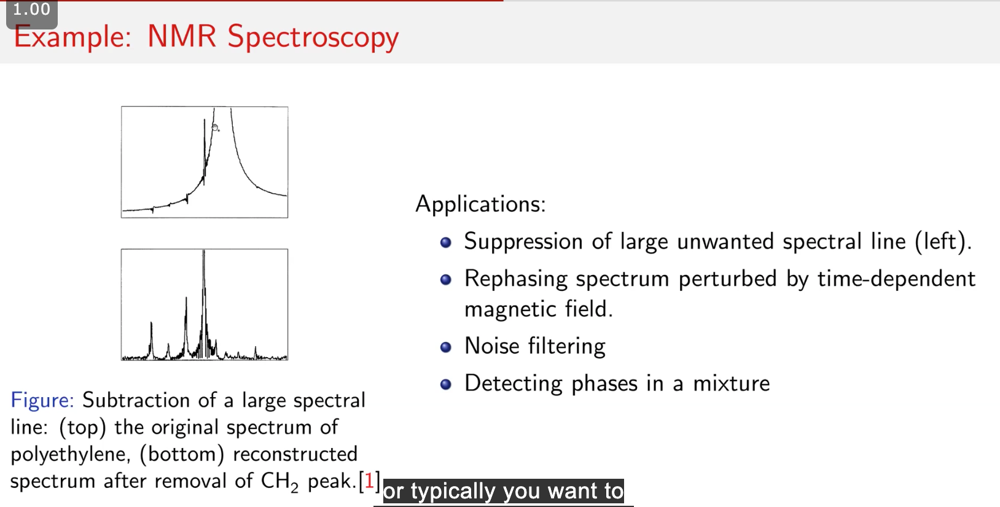

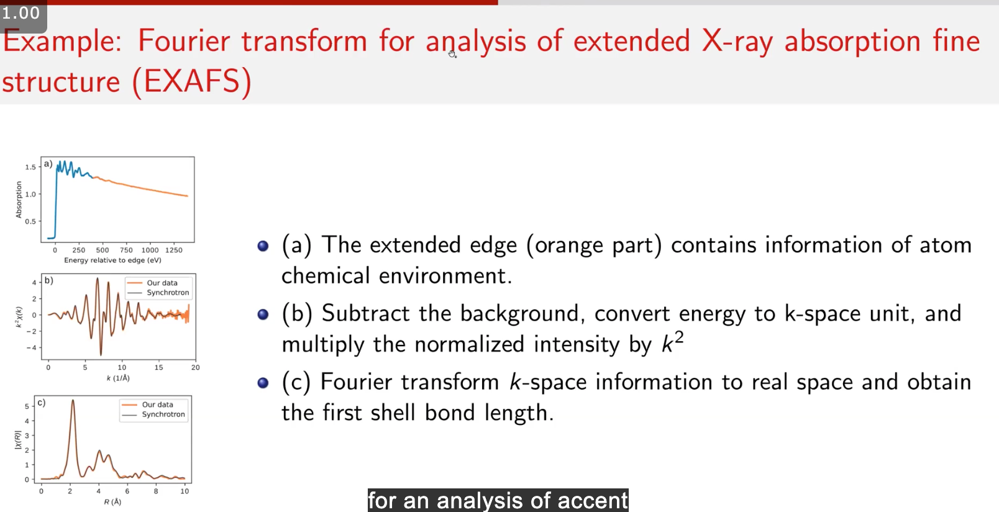

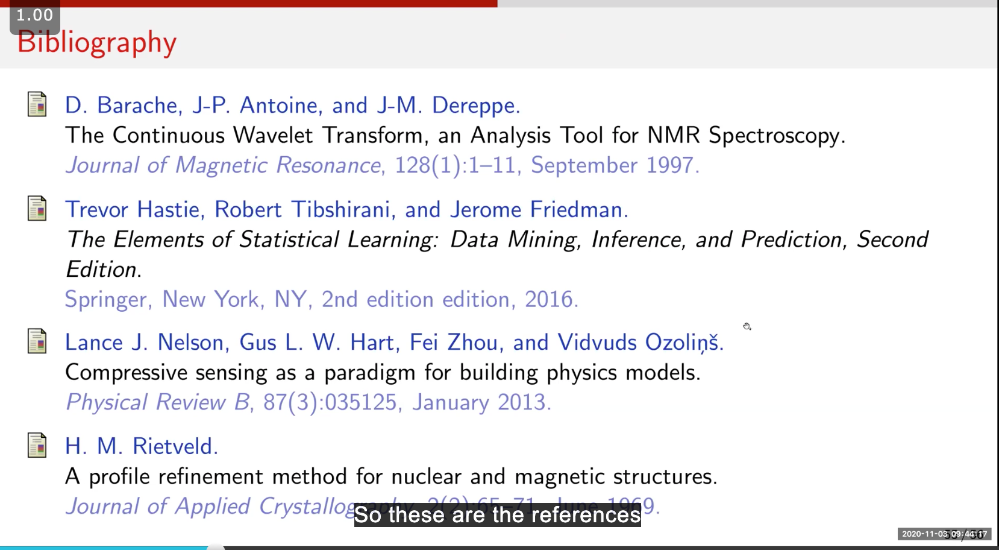

# Above is the linear methods
# Below is about valisation and classification

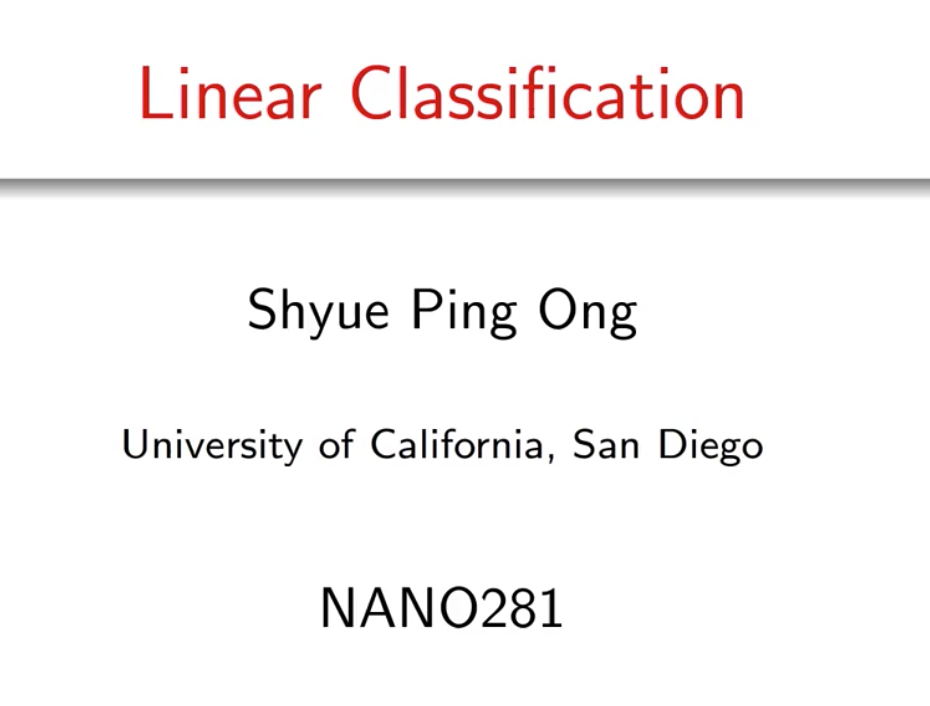

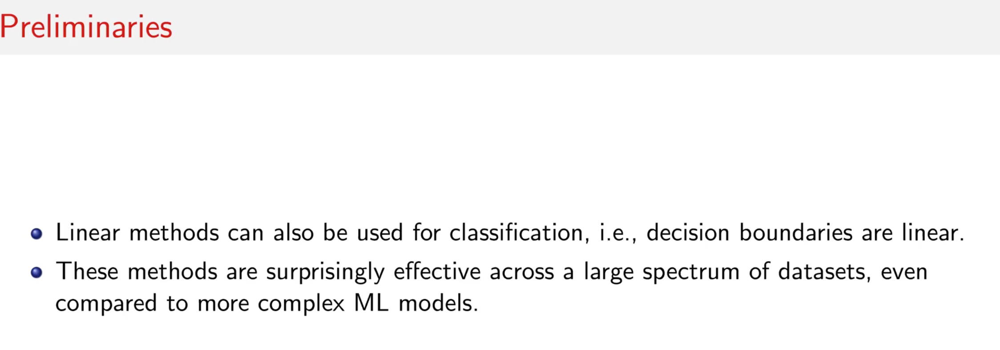

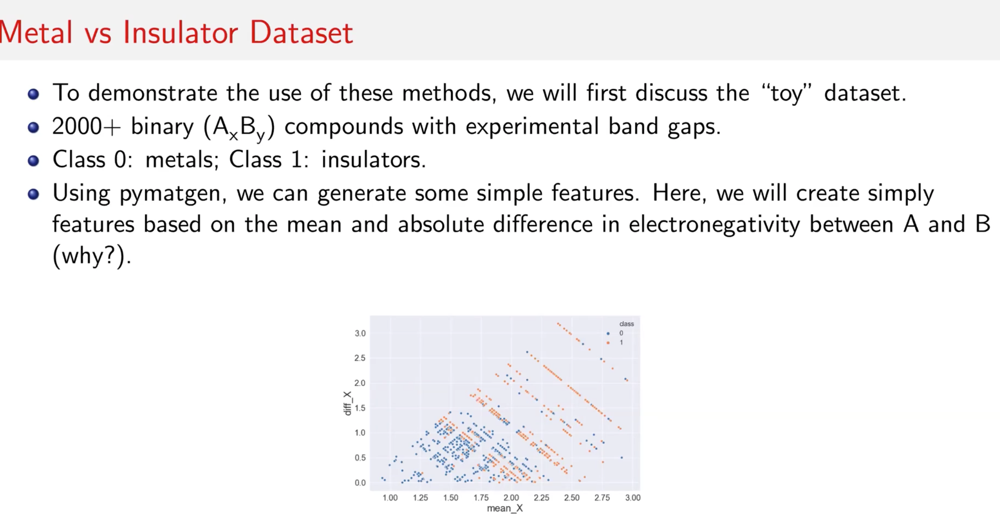

# Creating the deatures and classes


In [32]:
# Creating the deatures and classes

import pandas as pd
from pymatgen import Composition, Element
import numpy as np

import matplotlib.pyplot as plt
import matplotlib as mpl

binaries = pd.read_csv('binary_band_gap.csv')
binaries.head()


,Formula,Eg (eV)
0,AgAu3,0.00
1,BaAg2,0.00
2,AgBr,2.52
3,CdAg,0.00
4,AgCl,5.13


In [20]:
c = Composition('AgAu3')
print(c.as_dict())

defaultdict(<class 'float'>, {'Ag': 1.0, 'Au': 3.0})


In [21]:
# we create a column holding the Composition object
# Note the use of list comprehension in Python
binaries['composition'] = [Composition(c) for c in binaries['Formula']]
binaries['Xs'] = [[el.X for el in c ] for c in binaries['composition']]

binaries.head()


,Formula,Eg (eV),composition,Xs
0,AgAu3,0.00,"(Ag, Au)","[1.93, 2.54]"
1,BaAg2,0.00,"(Ba, Ag)","[0.89, 1.93]"
2,AgBr,2.52,"(Ag, Br)","[1.93, 2.96]"
3,CdAg,0.00,"(Cd, Ag)","[1.69, 1.93]"
4,AgCl,5.13,"(Ag, Cl)","[1.93, 3.16]"


In [24]:
# create the features mean and difference between electrneagatives
binaries['mean_X'] = [np.mean(xs) for xs in binaries['Xs']]
binaries['diff_X'] = [max(xs) - min(xs) for xs in binaries['Xs']]

binaries.head()

,Formula,Eg (eV),composition,Xs,mean_X,diff_X
0,AgAu3,0.00,"(Ag, Au)","[1.93, 2.54]",2.235,0.61
1,BaAg2,0.00,"(Ba, Ag)","[0.89, 1.93]",1.410,1.04
2,AgBr,2.52,"(Ag, Br)","[1.93, 2.96]",2.445,1.03
3,CdAg,0.00,"(Cd, Ag)","[1.69, 1.93]",1.810,0.24
4,AgCl,5.13,"(Ag, Cl)","[1.93, 3.16]",2.545,1.23


In [25]:
# Label metals (band gap of 0. 1e-5 is used as numerical tolerance) as class 0
# Insulators are labelled as class 1
binaries['class'] = [0 if eg < 1e-5 else 1 for eg in binaries ['Eg (eV)']]

binaries.head()


,Formula,Eg (eV),composition,Xs,mean_X,diff_X,class
0,AgAu3,0.00,"(Ag, Au)","[1.93, 2.54]",2.235,0.61,0
1,BaAg2,0.00,"(Ba, Ag)","[0.89, 1.93]",1.410,1.04,0
2,AgBr,2.52,"(Ag, Br)","[1.93, 2.96]",2.445,1.03,1
3,CdAg,0.00,"(Cd, Ag)","[1.69, 1.93]",1.810,0.24,0
4,AgCl,5.13,"(Ag, Cl)","[1.93, 3.16]",2.545,1.23,1


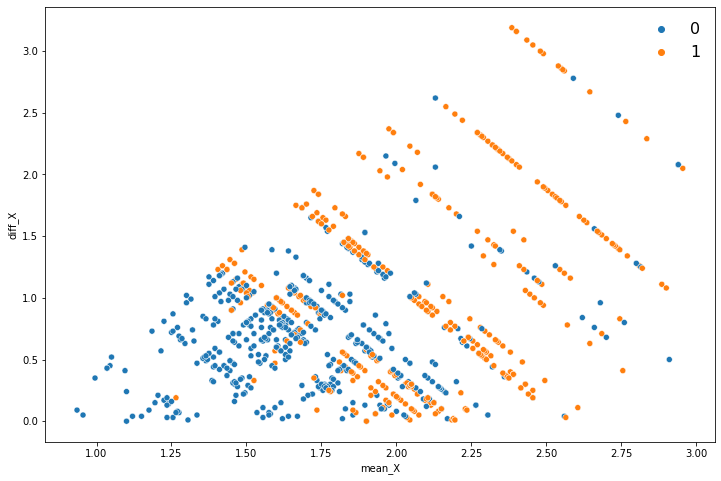

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize = (12, 8))
sns.scatterplot(x = 'mean_X', y = 'diff_X', hue = 'class', data = binaries)
plt.legend(frameon = False, fontsize =16)


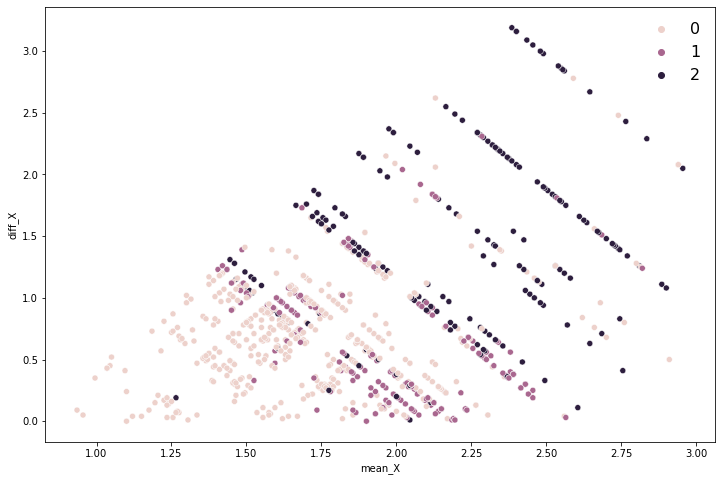

In [28]:

binaries['class'] = [0 if eg < 1e-5 else (1 if eg < 2 else 2) for eg in binaries ['Eg (eV)']]

plt.figure(figsize = (12, 8))
sns.scatterplot(x = 'mean_X', y = 'diff_X', hue = 'class', data = binaries)
plt.legend(frameon = False, fontsize =16)

In [2]:
from sklearn.model_selection import train_test_split

X = binaries[["mean_X", "diff_X"]]
y = binaries["class"]

# Test data is 10%
train_X, test_X, train_y, test_y = train_test_split(X, y, test_size=0.1, random_state=42)

NameError: name 'binaries' is not defined

In [3]:
from scipy import linalg

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

# #############################################################################
# Colormap
cmap = mpl.colors.LinearSegmentedColormap(
    'red_blue_classes',
    {'red': [(0, 1, 1), (1, 0.7, 0.7)],
     'green': [(0, 0.7, 0.7), (1, 0.7, 0.7)],
     'blue': [(0, 0.7, 0.7), (1, 1, 1)]})
plt.cm.register_cmap(cmap=cmap)


# #############################################################################
# Plot functions
def plot_data(da, X, y, plot_ellipses=True):
    sns.scatterplot(X["mean_X"], X["diff_X"], hue=y)

    # class 0 and 1 : areas
    nx, ny = 200, 100
    x_min, x_max = plt.xlim()
    y_min, y_max = plt.ylim()
    #  xx, yy creates points covering the entire 2D area
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, nx),
                         np.linspace(y_min, y_max, ny))
    # Predict the probability at any point
    Z = da.predict_proba(np.c_[xx.ravel(), yy.ravel()])
    Z = Z[:, 0].reshape(xx.shape)
    plt.pcolormesh(xx, yy, Z, cmap='red_blue_classes',
                   norm=mpl.colors.Normalize(0., 1.), zorder=0)
    # Contour plots with only one level, 0.5
    plt.contour(xx, yy, Z, [0.5], linewidths=2., colors='white')
    ax = plt.gca()
    
    if plot_ellipses:
        # means
        for i, mean in enumerate(da.means_):        
            plt.plot(mean[0], mean[1],
                     '*', color='yellow', markersize=15, markeredgecolor='grey')
            # This plots an Ellipse showing the location of the mean and covariance.
            if isinstance(da, LinearDiscriminantAnalysis):
                cov = da.covariance_
            else:
                cov = da.covariance_[i]
            v, w = linalg.eigh(cov)
            u = w[0] / linalg.norm(w[0])
            angle = np.arctan(u[1] / u[0])
            angle = 180 * angle / np.pi  # convert to degrees
            # filled Gaussian at 2 standard deviation
            ell = mpl.patches.Ellipse(mean, 2 * v[0] ** 0.5, 2 * v[1] ** 0.5,
                                      180 + angle, facecolor="grey",
                                      edgecolor='black', linewidth=2)
            ell.set_clip_box(ax.bbox)
            ell.set_alpha(0.2)
            ax.add_artist(ell)

    return plt

NameError: name 'mpl' is not defined

In [1]:
plt.figure(figsize=(12, 8))
# The hyperparameters such as `store_covariance` is set to a fixed value
lda = LinearDiscriminantAnalysis(solver="svd", store_covariance=True)

model = lda.fit(train_X, train_y)

y_pred = model.predict(test_X)
splot = plot_data(lda, test_X, test_y)

# Compute the test accuracy
splot.annotate("Accuracy = %.3f" % model.score(test_X, test_y), (1.25, 2), fontsize=20);

NameError: name 'plt' is not defined

/opt/anaconda3/envs/nano281/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


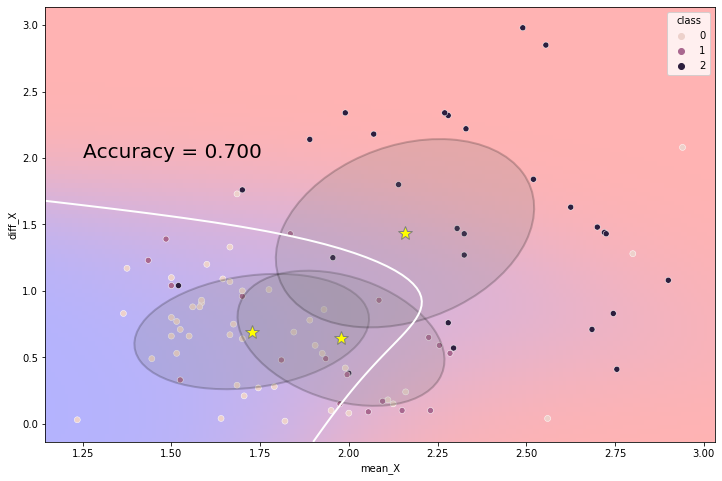

In [35]:

from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
qda = QuadraticDiscriminantAnalysis(store_covariance=True)
model = qda.fit(train_X, train_y)
y_pred = model.predict(test_X)

plot = plot_data(qda, test_X, test_y)
plot.annotate("Accuracy = %.3f" % model.score(test_X, test_y), (1.25, 2), fontsize=20);

/opt/anaconda3/envs/nano281/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


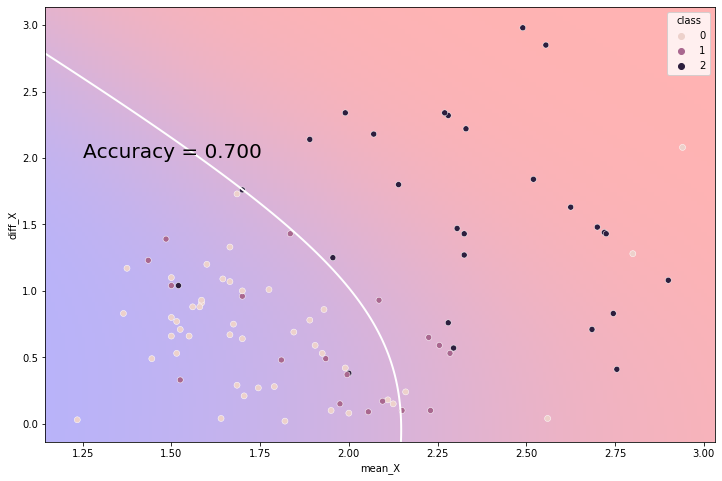

In [36]:
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression(penalty='none', solver='lbfgs')
model = clf.fit(train_X, train_y)
y_pred = model.predict(test_X)

plt.figure(figsize=(12, 8))
plot = plot_data(clf, test_X, test_y, plot_ellipses=False)
plot.annotate("Accuracy = %.3f" % model.score(test_X, test_y), (1.25, 2), fontsize=20);

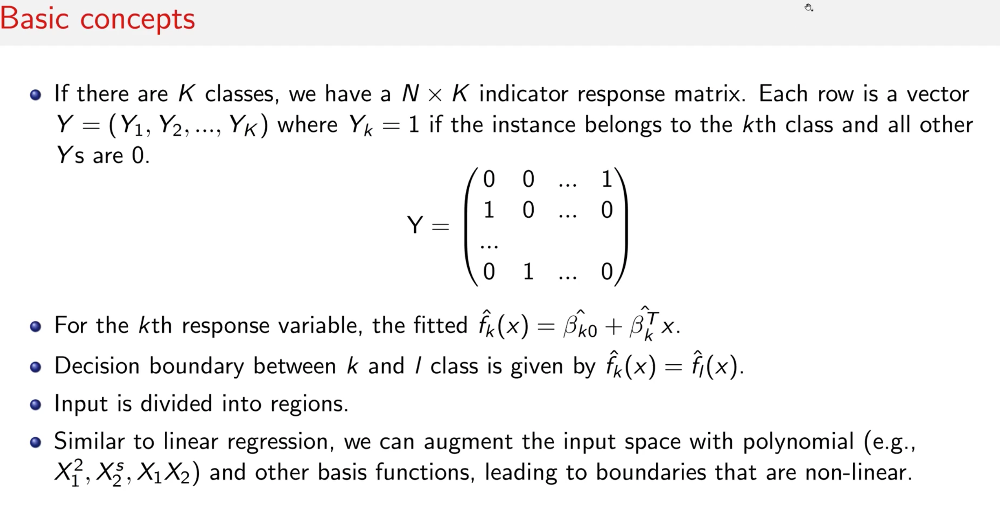

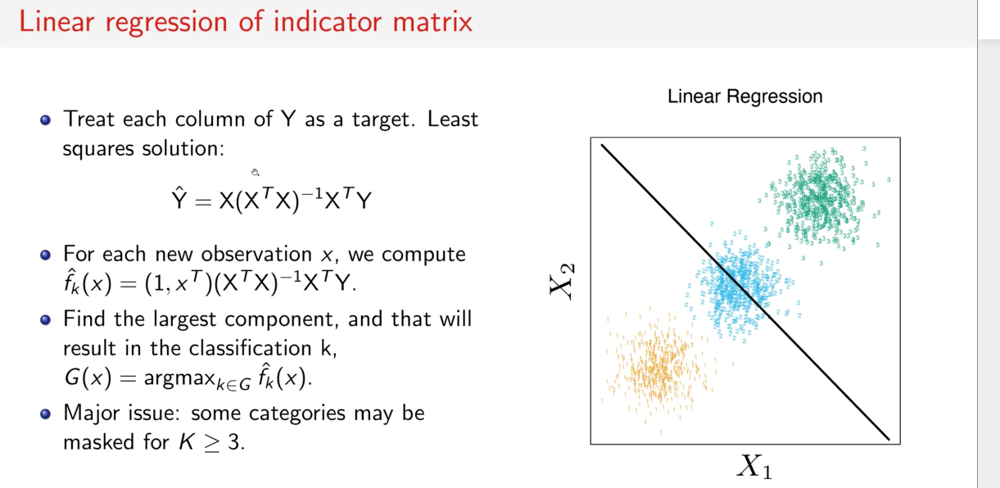

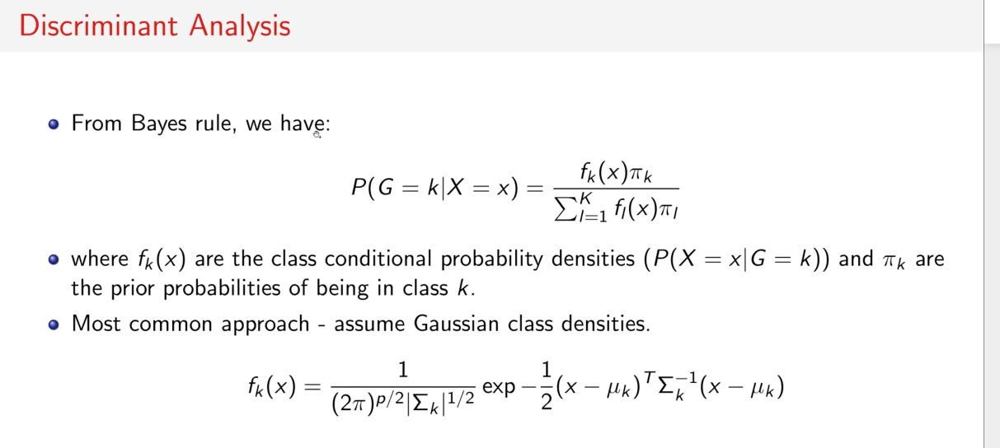

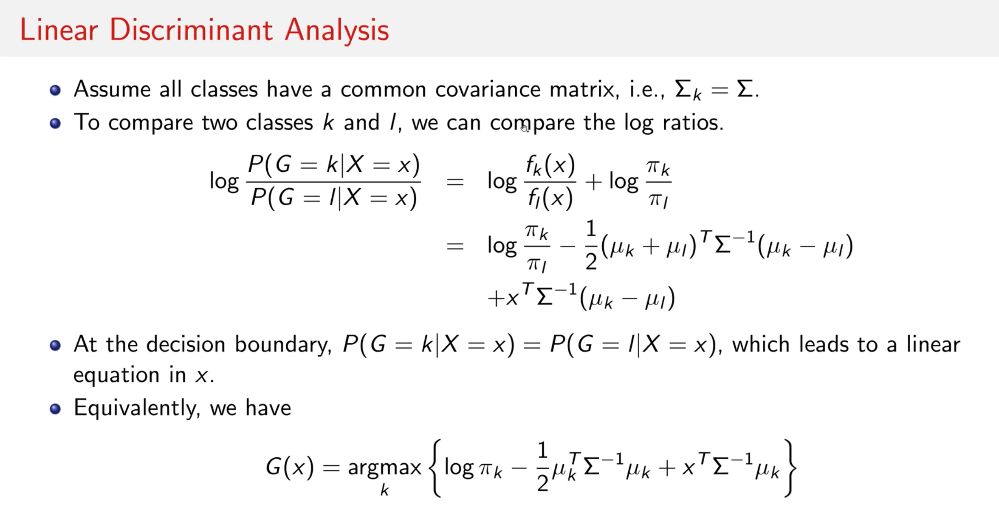

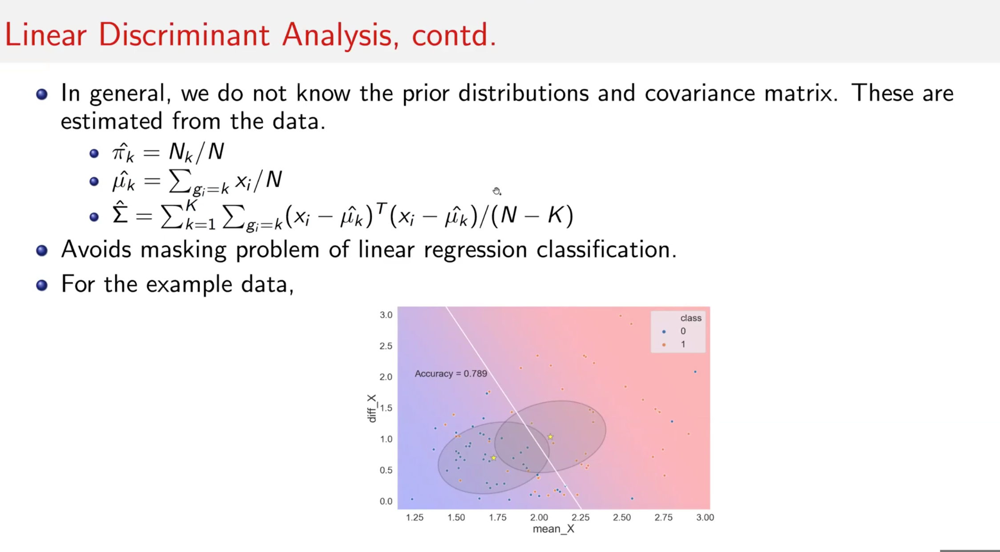

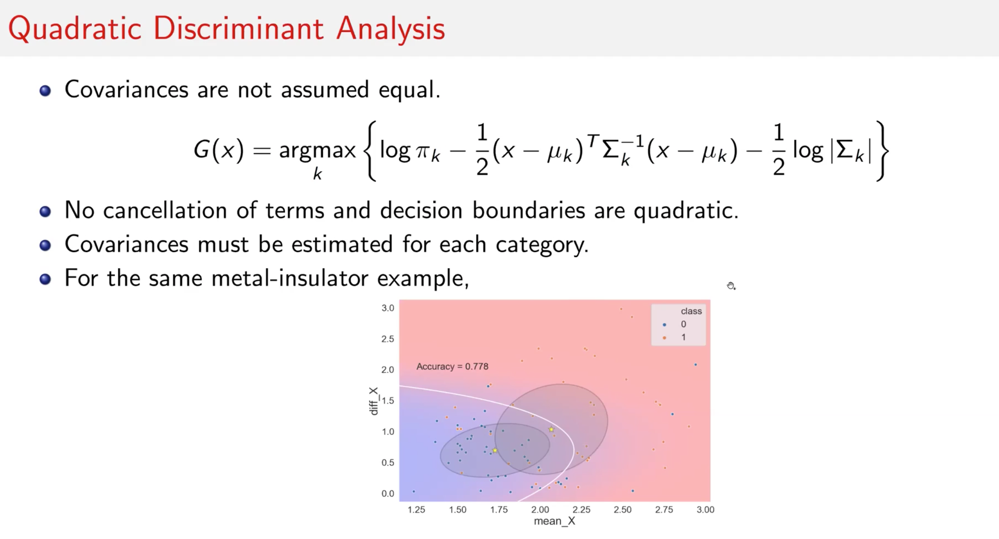

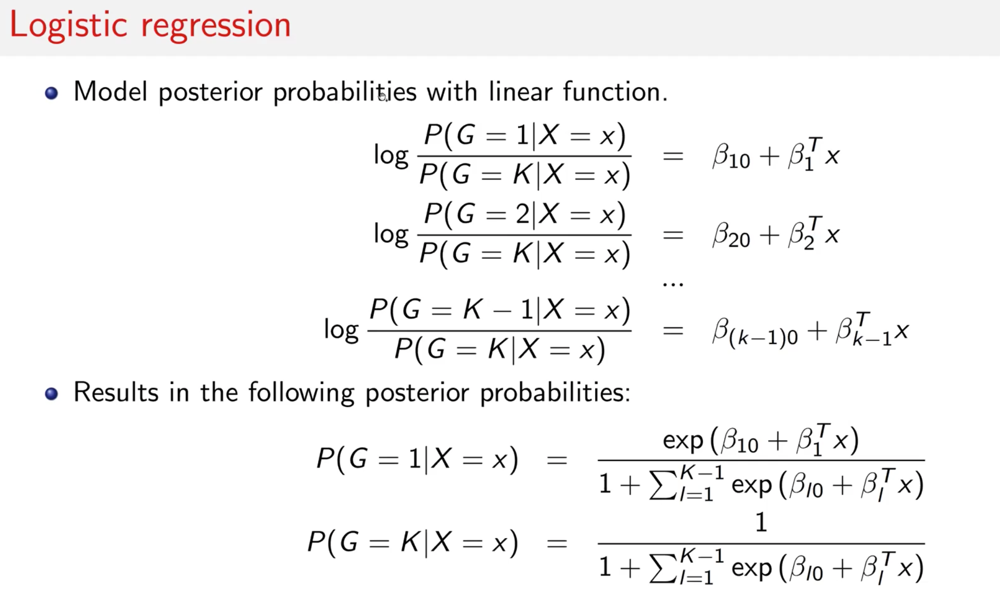

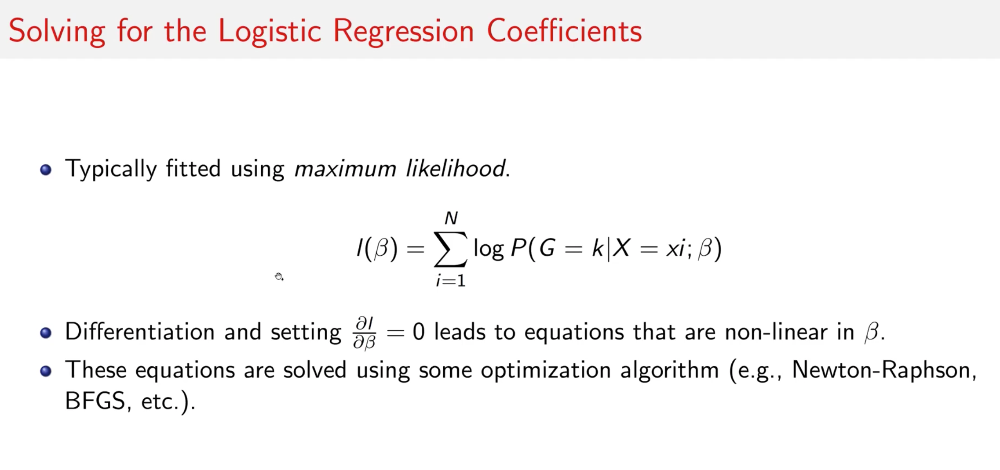

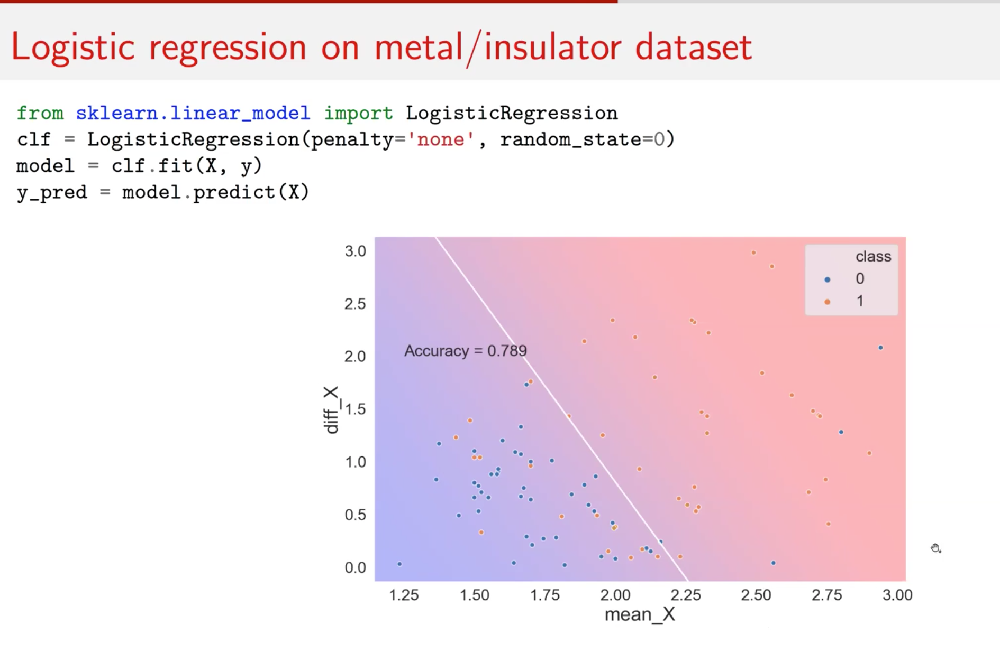

                 ~~~~~~~~~~~~~~~~~~~~~
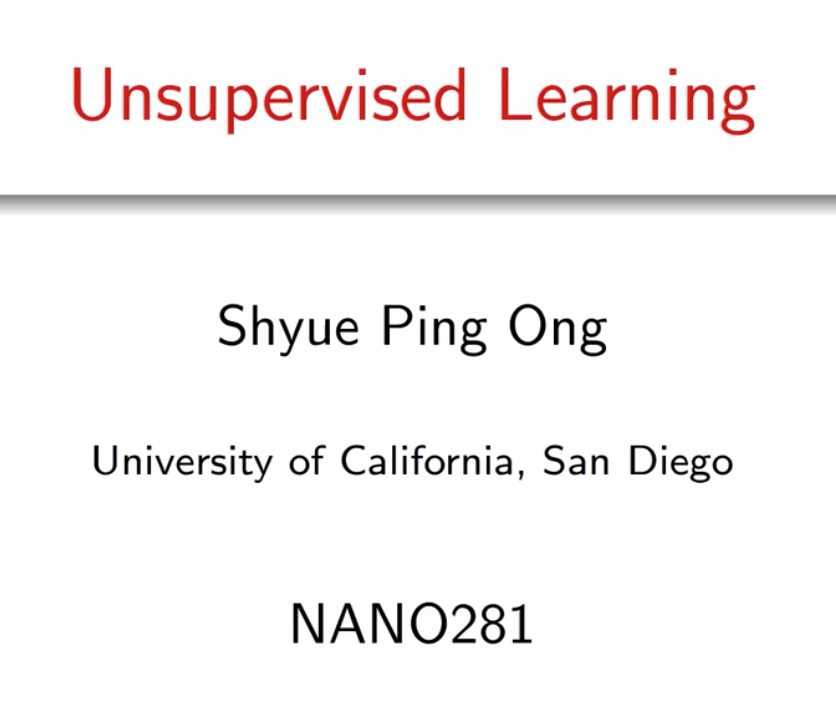

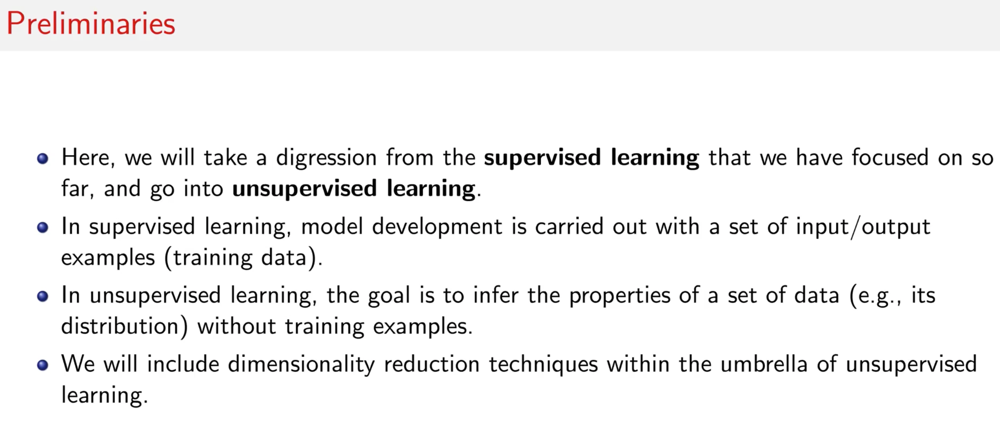

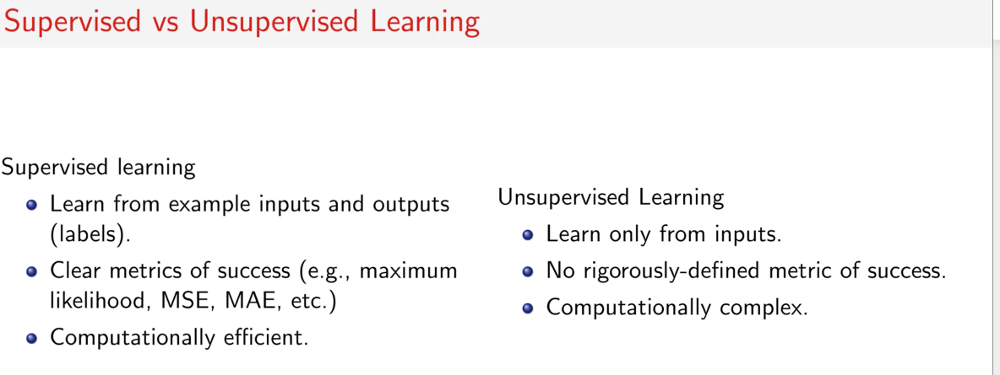

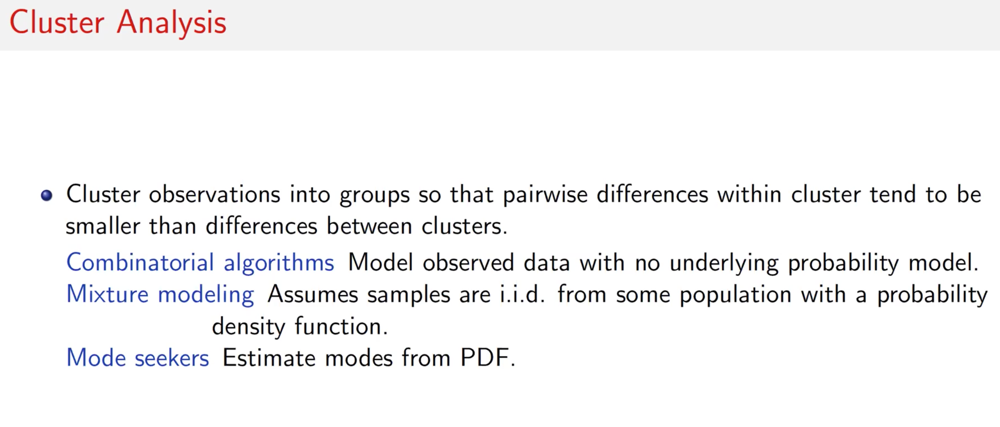

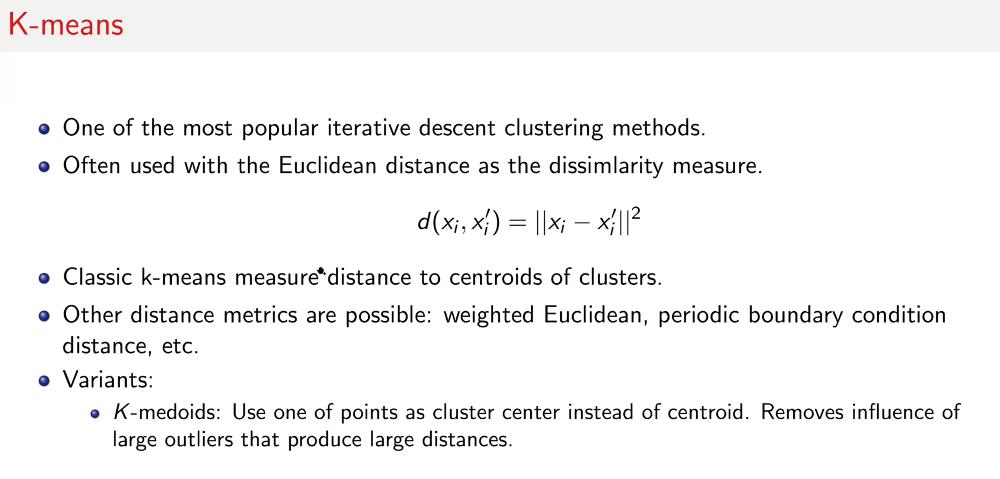

...

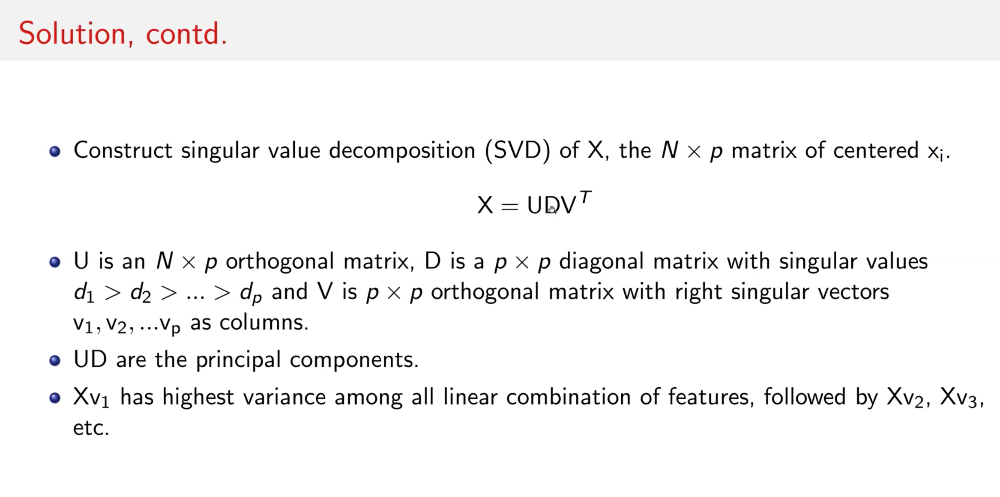

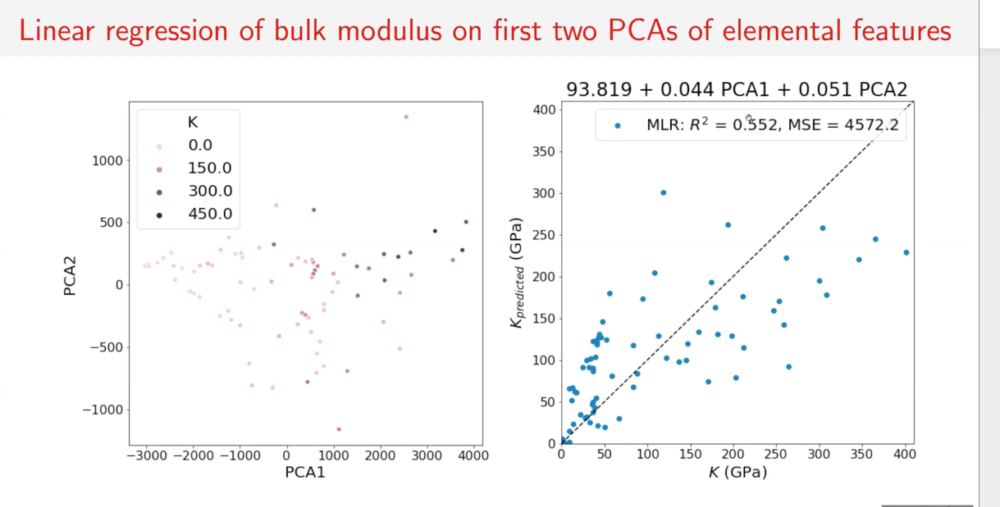

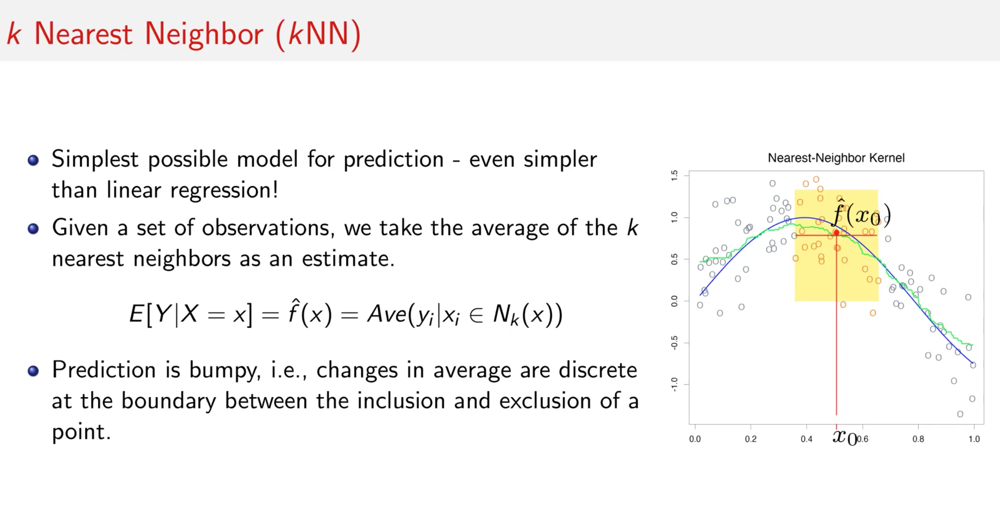

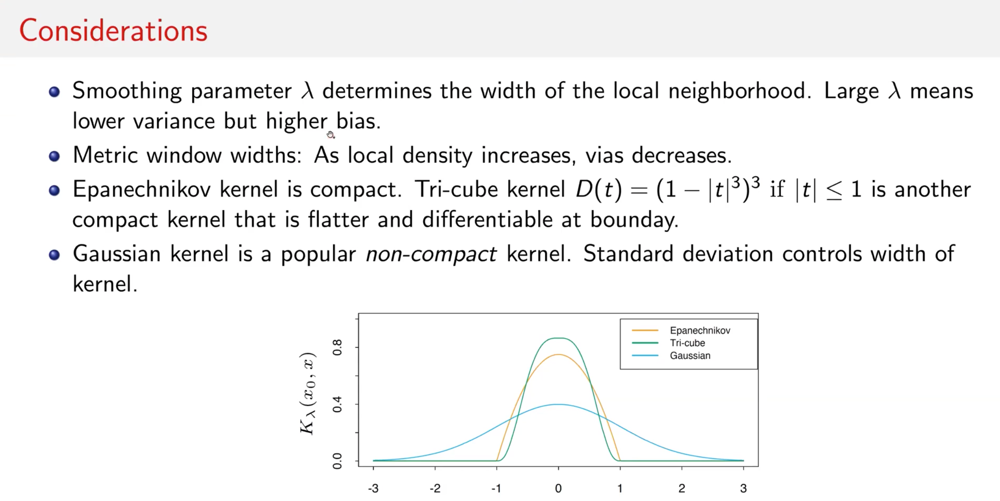

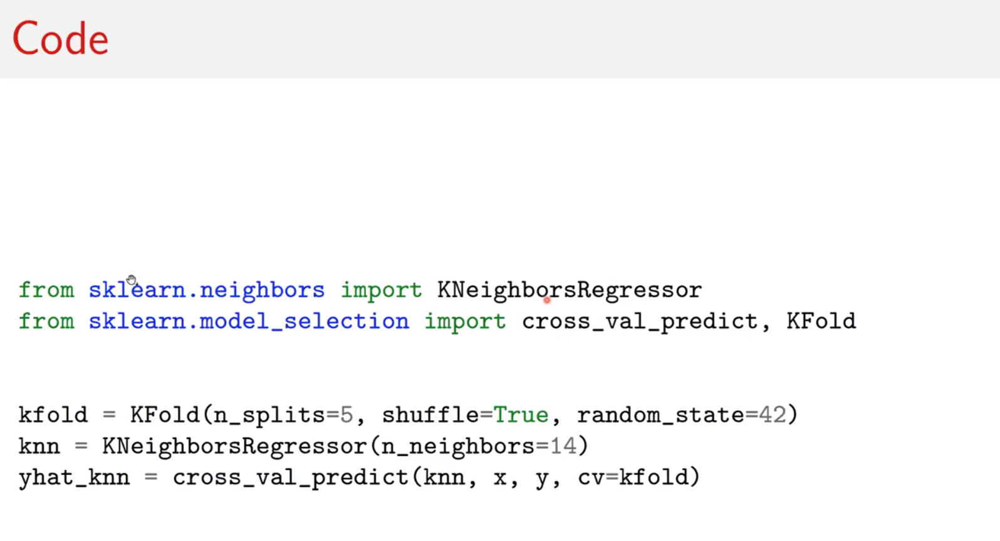